In [1]:
# %cd ..

In [2]:
# import sys

# sys.path.append('/workspace/Walk_Video_PyTorch/project')
# sys.path

In [3]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog

import torch

from matplotlib import pyplot as plt

from torchvision.io import read_video, write_video
from torchvision.utils import draw_bounding_boxes
import torchvision.transforms.functional as F

import os 


In [4]:
prefix_path = '/workspace/data/dataset/train/ASD'
sample_path_1 = '20170612_1_ASD_lat__V1-0005.mp4'

sample_path_2 = '20170619_2_ASD_lat__V1-0006.mp4'
sample_path_3 = '20170313_ASD_lat_ (1).mp4'
sample_path_4 = '20170328_ASD_lat_ (2).mp4'

sample_path_5 = '20170313_ASD_lat_V1-0002.mp4'

video, _, _ = read_video(os.path.join(prefix_path, sample_path_5), pts_unit='sec') # t,h,w,c

video.shape

torch.Size([110, 1080, 1920, 3])

In [12]:
torch.functional.(video[100][500])

AttributeError: module 'torch.functional' has no attribute 'totensor'

In [5]:
from batch_detection import batch_detection

get_bbox = batch_detection(img_size = 256)

In [6]:
frame_list, box_list, pred_list, center_point = get_bbox.get_frame_box(inp_imgs=video[:, :, :, :]) # t, h, w, c


/usr/local/lib/python3.9/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.9/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/usr/local/lib/python3.9/dist-packages/detectron2/structures/boxes.py:233: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instea

In [7]:
frame_list[0].shape, box_list[0], pred_list[0]

(torch.Size([1080, 1920, 3]),
 tensor([[1302.9944,  299.1365, 1501.8496,  768.5805]]),
 Instances(num_instances=1, image_height=1080, image_width=1920, fields=[pred_boxes: Boxes(tensor([[1302.9944,  299.1365, 1501.8496,  768.5805]])), scores: tensor([0.9994]), pred_classes: tensor([0])]))

In [8]:
box_list, center_point

([tensor([[1302.9944,  299.1365, 1501.8496,  768.5805]]),
  tensor([[1295.8667,  301.6299, 1502.6185,  768.8412]]),
  tensor([[1291.4202,  301.5892, 1500.3010,  770.2510]]),
  tensor([[1290.8938,  303.8785, 1501.4507,  769.0259]]),
  tensor([[1290.1141,  303.3963, 1498.8716,  766.1873]]),
  tensor([[1286.6677,  293.6664, 1487.2930,  767.0211]]),
  tensor([[1286.1100,  291.9702, 1484.5469,  768.6947]]),
  tensor([[1282.1241,  288.9965, 1479.2812,  767.7850]]),
  tensor([[1277.2703,  289.3009, 1468.3999,  766.4925]]),
  tensor([[1268.9492,  291.5654, 1452.9086,  768.8428]]),
  tensor([[1263.8406,  292.2193, 1444.2649,  771.6722]]),
  tensor([[1251.0641,  288.8997, 1432.6449,  771.0314]]),
  tensor([[1245.8782,  289.9363, 1421.9803,  768.8437]]),
  tensor([[1233.6890,  293.8363, 1393.9340,  769.6588]]),
  tensor([[1225.1477,  299.1246, 1390.7399,  769.7901]]),
  tensor([[1204.1381,  296.8100, 1388.4762,  771.6611]]),
  tensor([[1182.1709,  296.7352, 1387.0815,  765.9362]]),
  tensor([[114

In [9]:
# plt.figure(figsize=(512, 512))

# drawn_boxes_list = []

# for num in range(len(frame_list)):

#     drawn_boxes = draw_bounding_boxes(frame_list[num].permute(2, 0, 1), box_list[num], colors="red")

#     drawn_boxes_list.append(drawn_boxes)
#     plt.subplot(len(frame_list), 1, num+1)
#     plt.imshow(drawn_boxes.permute(1, 2, 0))



In [10]:
# frame_list, box_list, pred_list, center_point = get_bbox.get_frame_box(inp_imgs=video[:, :, :, :]) # t, h, w, c

one_batch = get_bbox.handel_batch_imgs(video_frame=video)

In [11]:
write_video(filename='output.mp4', video_array=one_batch.permute(1, 2, 3, 0), fps=30) # (c, t, h, w) to (t, h, w, c)

In [12]:
plt.figure(figsize=(512, 512))

v = Visualizer(frame_list[-19], instance_mode=ColorMode(1), scale=1.0)

out = v.draw_instance_predictions(pred_list[-19])

plt.imshow(out.get_image())

In [13]:
from pytorchvideo.transforms.functional import (
    uniform_temporal_subsample,
    short_side_scale_with_boxes,
    clip_boxes_to_image,
    uniform_crop_with_boxes,
    random_crop_with_boxes,
)
from pytorchvideo.data.encoded_video import EncodedVideo

In [14]:
# Load the video
encoded_vid = EncodedVideo.from_path(os.path.join(prefix_path, sample_path_5))
print('Completed loading encoded video.')
video = encoded_vid.get_clip(0, 1)['video']
video.shape

Completed loading encoded video.


torch.Size([3, 24, 1080, 1920])

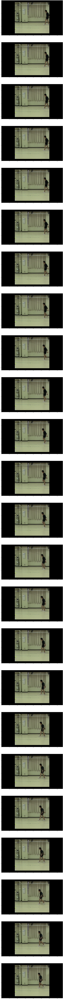

In [15]:
plt.figure(figsize=(512, 512))

c, t, h, w = video.shape 

for num in range(t):

    plt.subplot(t, 1, num+1)
    plt.imshow(video.permute(1, 2, 3, 0)[num] / 255)



In [16]:

batch = uniform_temporal_subsample(video, 5)
batch.shape

torch.Size([3, 5, 1080, 1920])

In [17]:
plt.figure(figsize=(512, 512))

c, t, h, w = batch.shape 

for num in range(t):

    plt.subplot(1, t, num+1)
    plt.imshow(batch.permute(1, 2, 3, 0)[num] / 255)



In [18]:
# plt.figure(figsize=(512, 512))

# for num in range(len(frame_list)):

#     # v = Visualizer(frame_list[num], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
#     v = Visualizer(frame_list[num], instance_mode=ColorMode(1), scale=1.0)

#     out = v.draw_instance_predictions(pred_list[num])

#     plt.subplot(len(frame_list), 1, num+1) 

#     plt.imshow(out.get_image())
